<a href="https://colab.research.google.com/github/sabrinaMKE201073/PIL-Python-library/blob/main/Pillow_(Python_library_for_Image_processing).ipynb" target="_parent"><img src="https://colab.research.google.com/assets/colab-badge.svg" alt="Open In Colab"/></a>

<h1><b>Pillow: Ultimate Python Library for Image Processing</h1>

- Pillow Library (PIL) : A python library to perform image processing functionalities.


In [1]:
import os
from PIL import Image
import matplotlib.pyplot as plt
from PIL import ImageOps
import numpy as np
%matplotlib inline

# You can also use this section to suppress warnings generated by your code:
def warn(*args, **kwargs):
    pass
import warnings
warnings.warn = warn
warnings.filterwarnings('ignore')

In [2]:
#define helper function to concatenate two images side-by-side/horizontally
def get_concat_h(im1, im2):
    dst = Image.new('RGB', (im1.width + im2.width, im1.height))
    dst.paste(im1, (0, 0))
    dst.paste(im2, (im1.width, 0))
    return dst

In [3]:
my_image = "/content/drive/MyDrive/Colab Notebooks/Image A.JPEG"
my_image

'/content/drive/MyDrive/Colab Notebooks/Image A.JPEG'

In [4]:
cwd = os.getcwd()
cwd

'/content'

In [5]:
image_path = os.path.join(cwd, my_image)
image_path

'/content/drive/MyDrive/Colab Notebooks/Image A.JPEG'

In [6]:
#Load Images in Python
image = Image.open(my_image)
type(image)

PIL.JpegImagePlugin.JpegImageFile

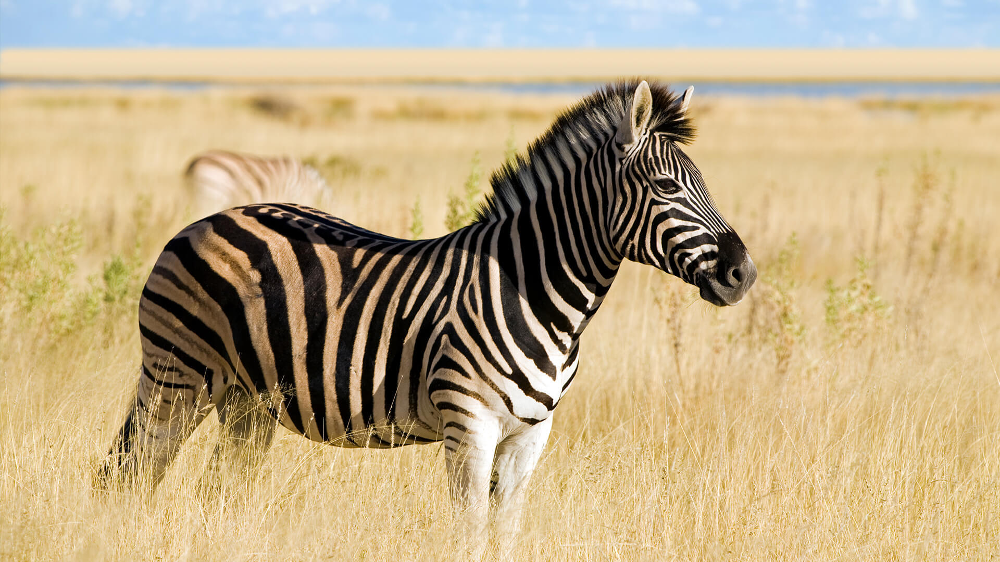

In [7]:
#view the image
image

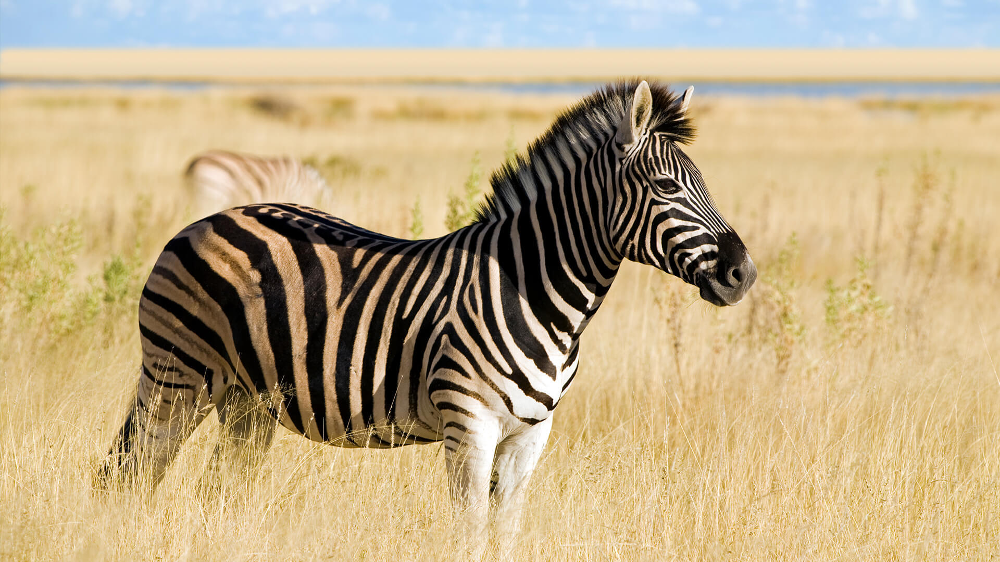

In [8]:
#Plot the image
image.show()

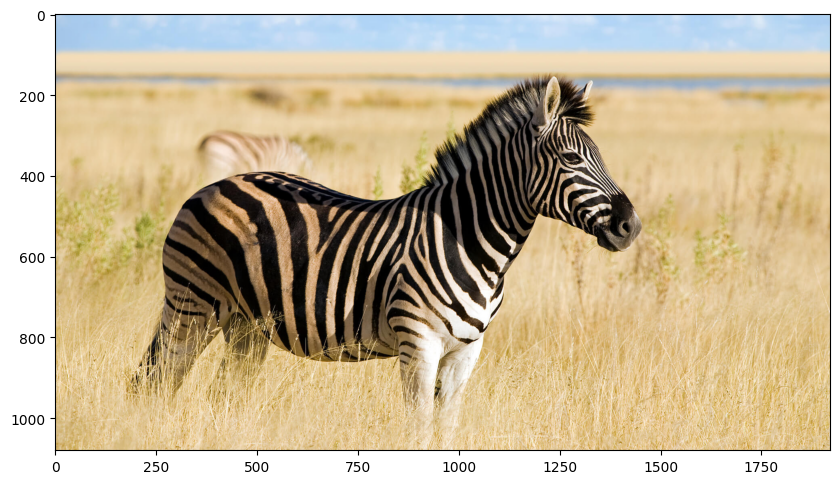

In [9]:
#next method to display image
#by using imshow from matplotlib library
plt.figure(figsize=(10,10))
plt.imshow(image)
plt.show()

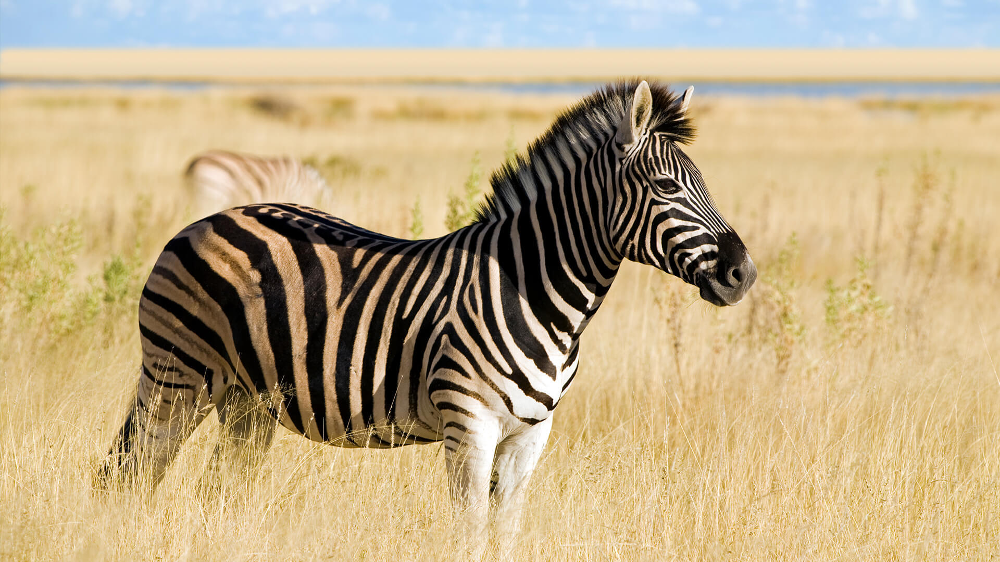

In [12]:
#we can also load the image using its full path
image = Image.open(image_path)
image

In [13]:
#see the image size (width, height)
print(image.size)

(1920, 1080)


In [15]:
#see pixel format used in the image (RGB stand for color space red, green, blue)
print(image.mode)

RGB


In [16]:
#The Image.open method does not load image data into the computer memory.
#The load method of PIL object reads the file content, decodes it, and expands the image into memory.
im = image.load()

In [17]:
#check the intensity of image at x-column, y-row
x = 0
y = 1
im[y,x]

(175, 203, 227)

In [18]:
#save image as jpg format
image.save("zebra.jpg")

# **GRAYSCALE IMAGES**

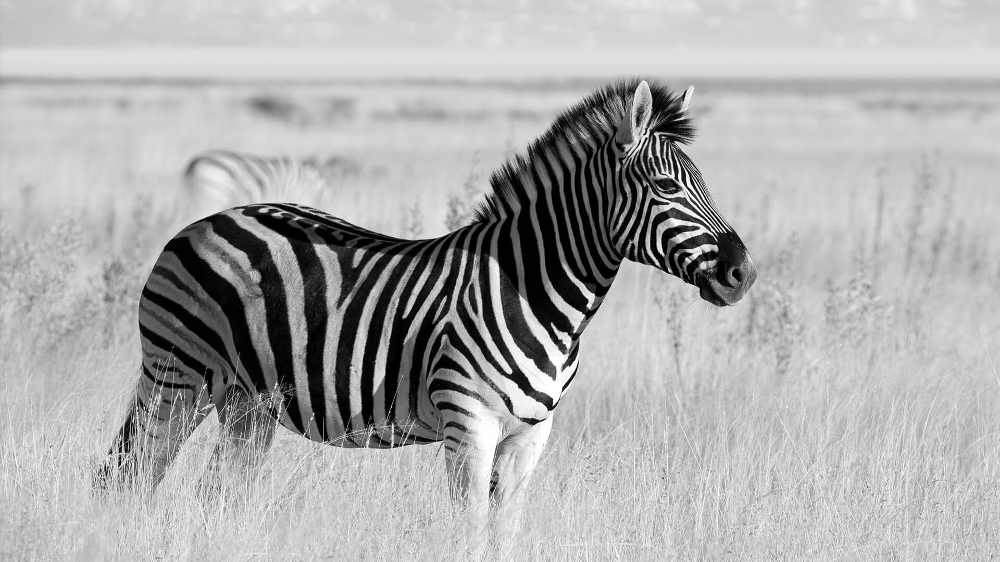

In [20]:
#change image to grayscale
image_gray = ImageOps.grayscale(image)
image_gray

In [21]:
#check mode of the image (L = grayscale image)
image_gray.mode

'L'

<b>Quantization

- The Quantization of an image is the number of unique intensity values any given pixel of the image can take. For a grayscale image, this means the number of different shades of gray. Most images have 256 different levels. You can decrease the levels using the method quantize. Let's repeatably cut the number of levels in half and observe what happens:

Half the levels do not make a noticable difference.

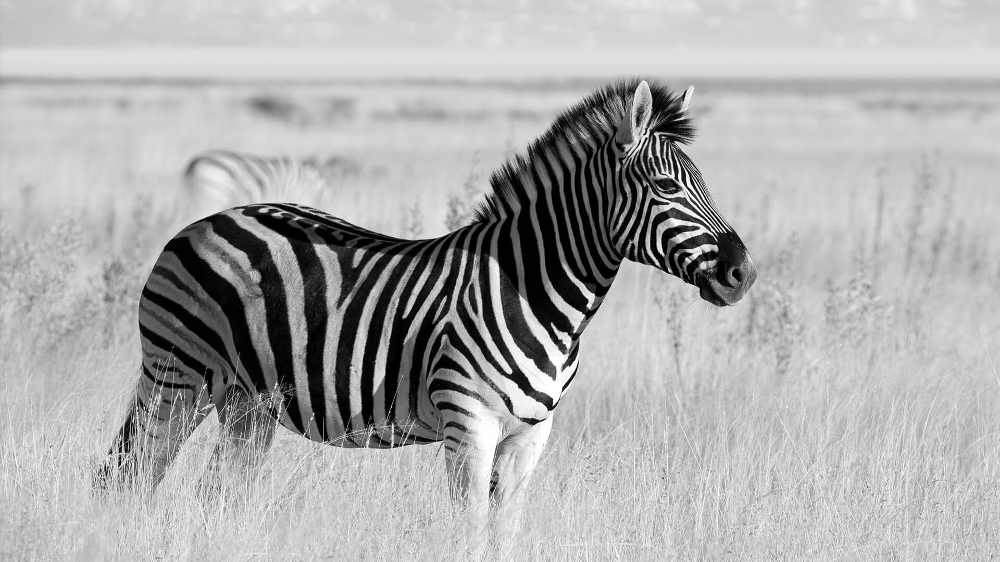

In [22]:
#first Quantization
image_gray.quantize(256 // 2)
image_gray

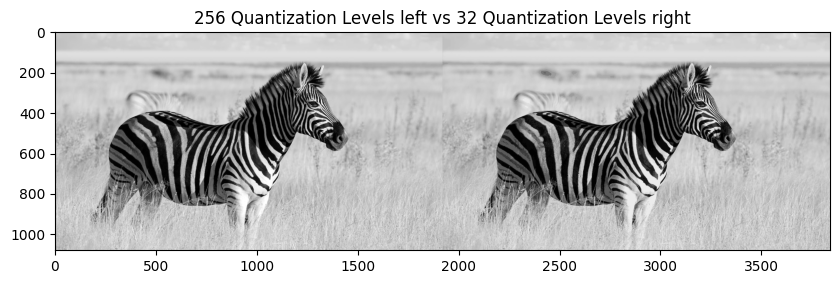

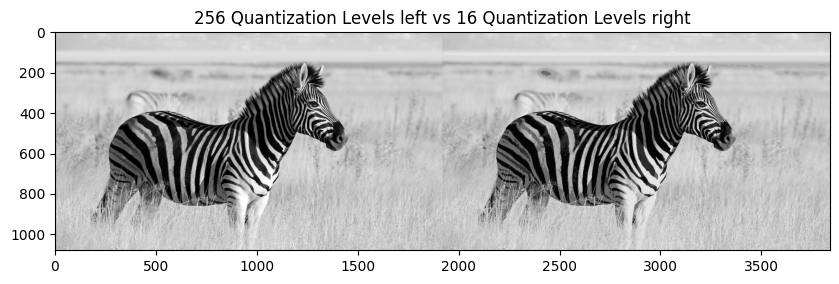

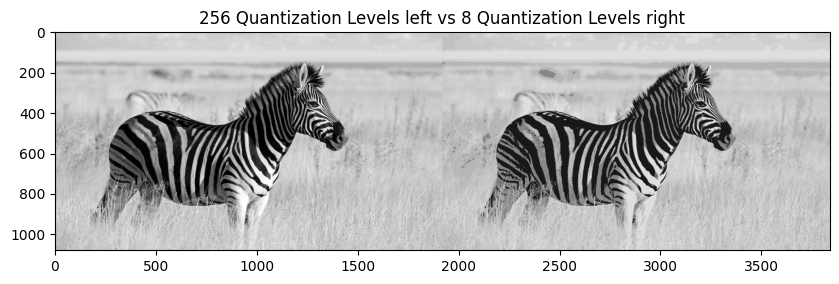

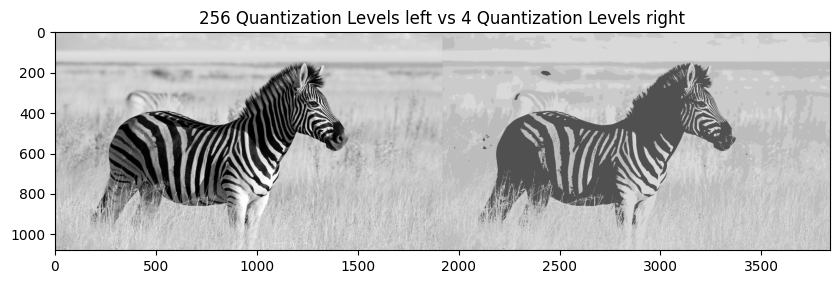

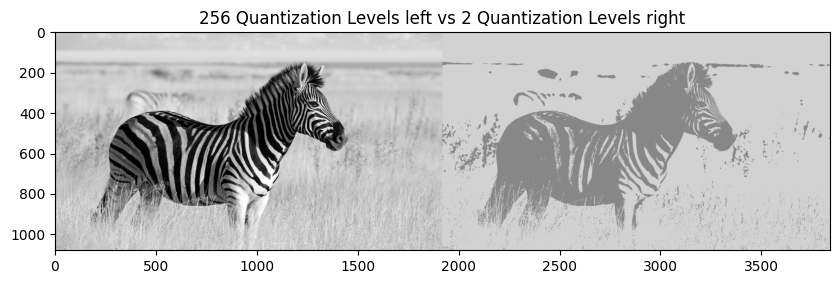

In [23]:
#continue dividing the number of values by two and compare it to the original image.
#get_concat_h(image_gray,  image_gray.quantize(256//2)).show(title="Lena")
for n in range(3,8):
    plt.figure(figsize=(10,10))
    plt.imshow(get_concat_h(image_gray,  image_gray.quantize(256//2**n)))
    plt.title("256 Quantization Levels left vs {} Quantization Levels right".format(256//2**n))
    plt.show()

# **COLOR CHANNEL IMAGES**

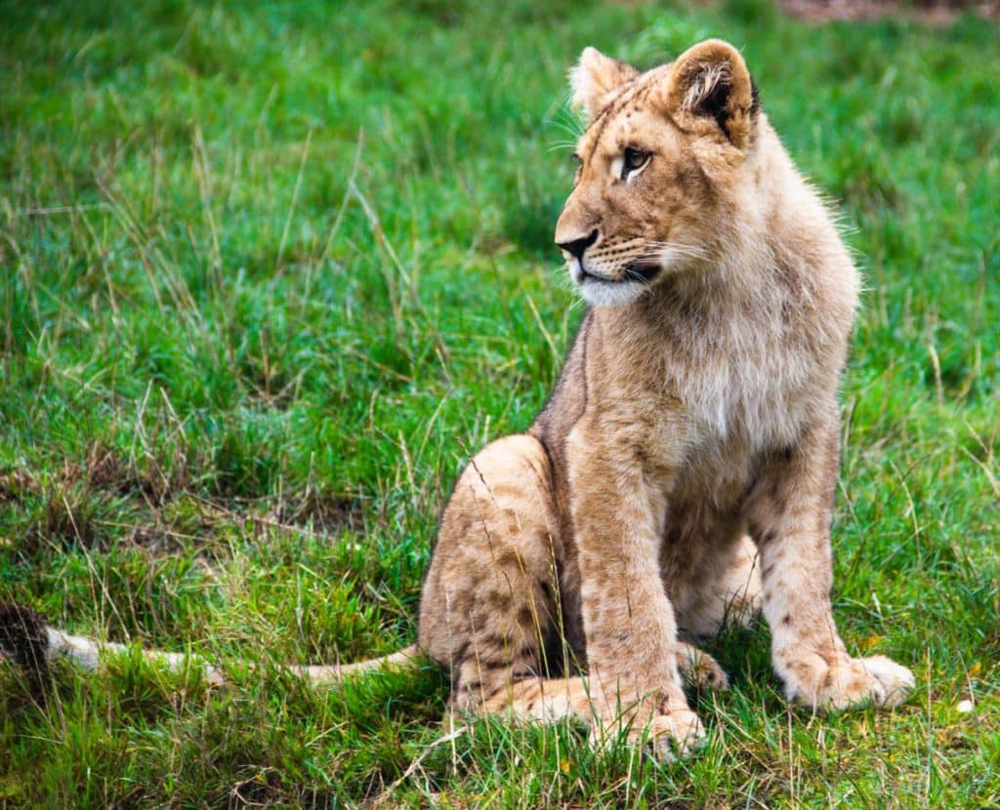

In [24]:
#try do the process on second image
tiger = Image.open('/content/drive/MyDrive/Colab Notebooks/Image B.jpeg')
tiger

In [25]:
#obtain different RGB color channel and assign them to variables R,G and B

red, green, blue = tiger.split()

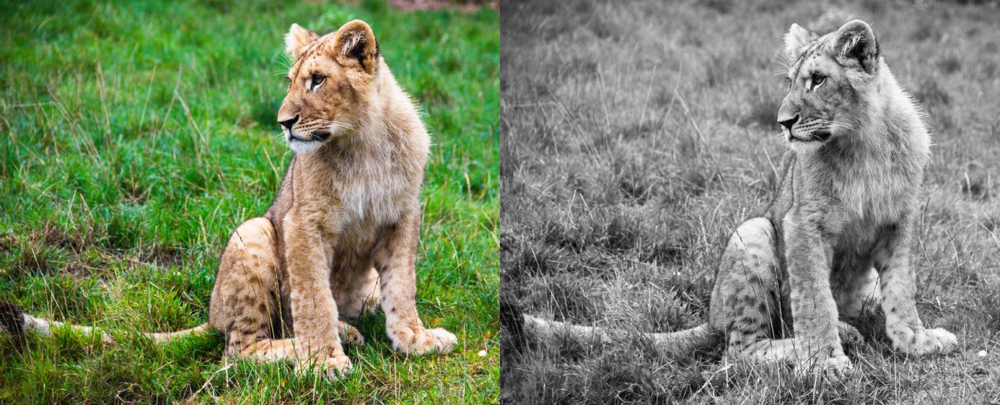

In [27]:
#Plotting the color image next to the green channel as a grayscale,
#to we see that regions with higher intensity values.
get_concat_h(tiger, green)

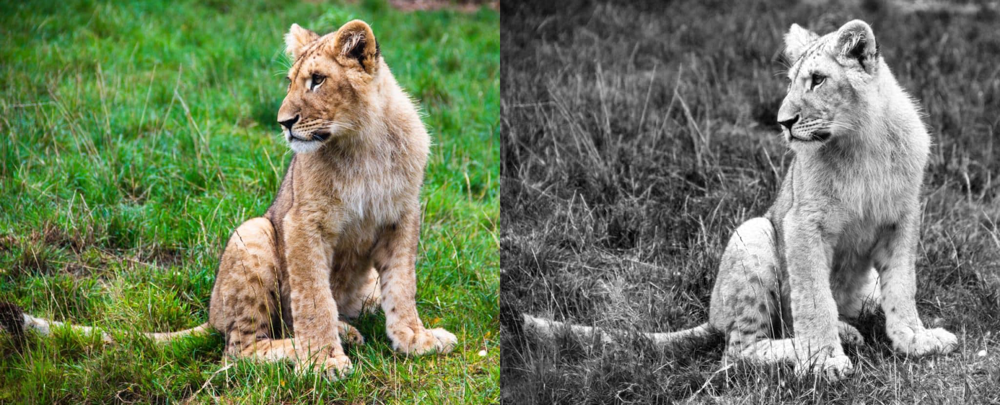

In [28]:
#do the same for blue and red
get_concat_h(tiger, red)

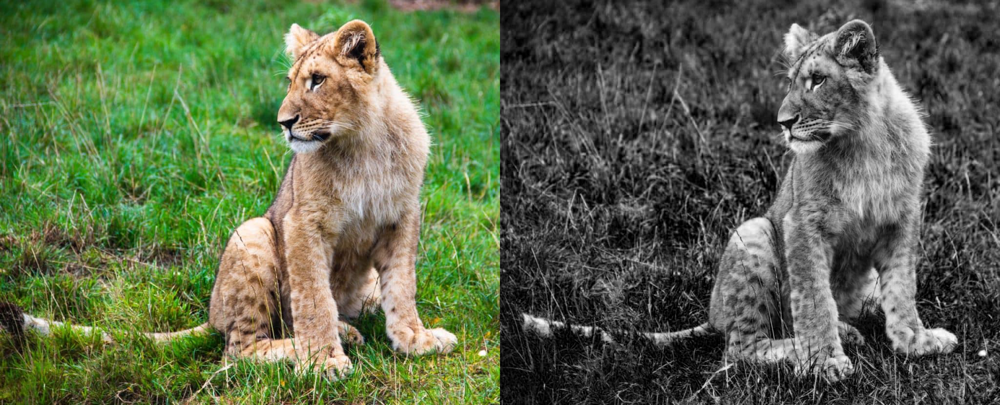

In [29]:
#do the same for blue and red
get_concat_h(tiger, blue)

# **PIL Images into NumPy Arrays**

- NumPy is a library for Python, allowing you to work with multi-dimensional arrays and matrices. \
- We can convert a PIL image to a NumPy array.
- by using asarray() or array function from NumPy to convert PIL images into NumPy arrays.

In [30]:
array= np.asarray(image)
print(type(array))

<class 'numpy.ndarray'>


- np.asarray turns the original image into a numpy array. Often, we don't want to manipulate the image directly, but instead, create a copy of the image to manipulate.
- The np.array method creates a new copy of the image, such that the original one will remain unmodified.

In [31]:
array = np.array(image)

In [32]:
#summarize shape
print(array.shape)


(1080, 1920, 3)


In [34]:
print(array)
#The Intensity values are 8-bit unsigned datatype.

[[[172 200 224]
  [175 203 227]
  [178 206 230]
  ...
  [183 212 242]
  [185 212 242]
  [185 212 242]]

 [[172 200 224]
  [175 203 227]
  [178 206 230]
  ...
  [182 211 241]
  [185 212 242]
  [185 212 242]]

 [[172 200 224]
  [175 203 227]
  [179 207 231]
  ...
  [182 211 241]
  [182 211 241]
  [183 212 242]]

 ...

 [[208 182 123]
  [209 181 116]
  [208 178 108]
  ...
  [217 181 119]
  [217 185 124]
  [235 209 150]]

 [[212 186 127]
  [211 183 120]
  [208 178 108]
  ...
  [227 197 137]
  [222 195 140]
  [228 206 156]]

 [[214 188 131]
  [213 185 122]
  [208 178 108]
  ...
  [235 209 152]
  [223 202 149]
  [215 198 152]]]


In [35]:
#check image at first row
array[0, 0]

array([172, 200, 224], dtype=uint8)

In [36]:
#find max and min intensity value of array
array.min()

0

In [37]:
array.max()

255

# **Indexing**

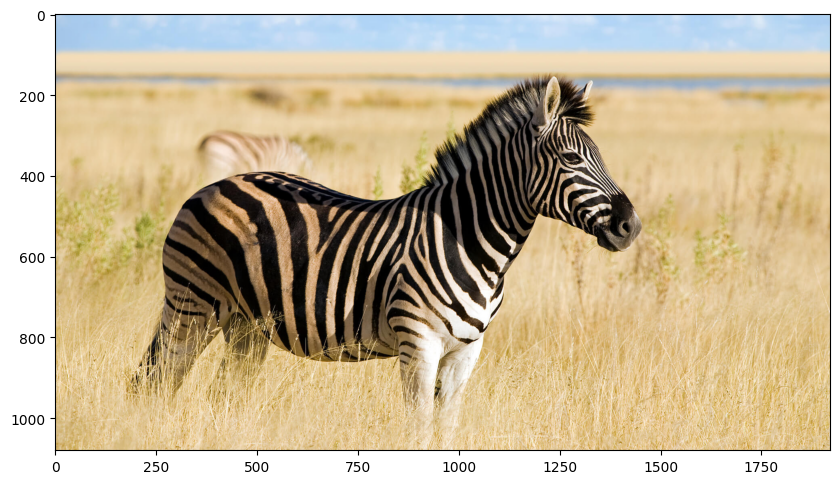

In [38]:
#plot array as an image
plt.figure(figsize=(10,10))
plt.imshow(array)
plt.show()

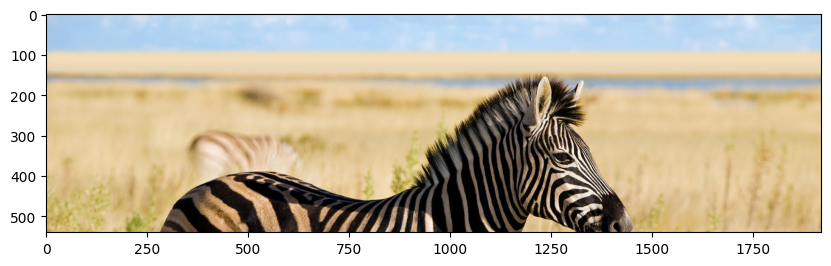

In [46]:
#use numpy slicing, for example, we can return the first 1080/2 = 540 rows (the top half of the image)

rows = 540
plt.figure(figsize=(10,10))
plt.imshow(array[0:rows,:,:])
plt.show()

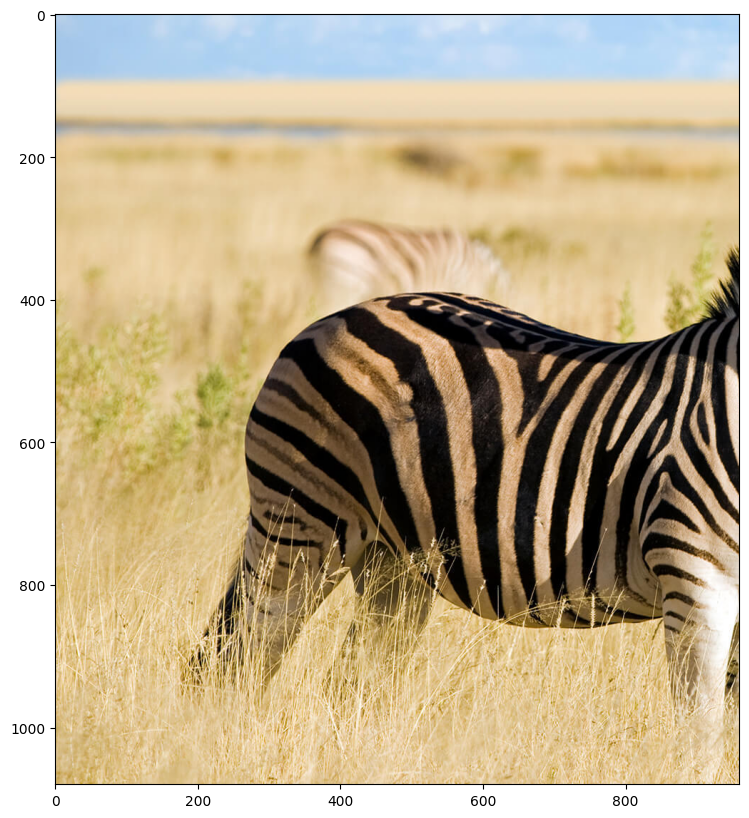

In [47]:
#use numpy slicing, for example,
#to return the first 1920/2 = 960 column (the first half of the image)

columns = 960
plt.figure(figsize=(10,10))
plt.imshow(array[:,0:columns,:])
plt.show()

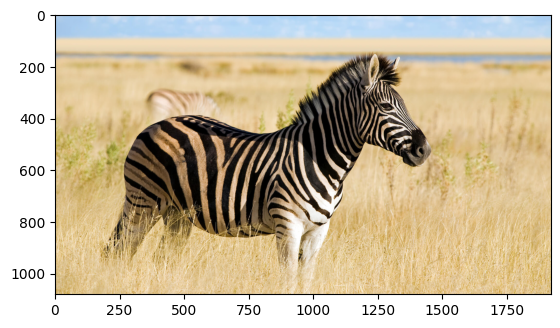

In [48]:
#If you want to reassign an array to another variable, you should use the copy method
A = array.copy()
plt.imshow(A)
plt.show()

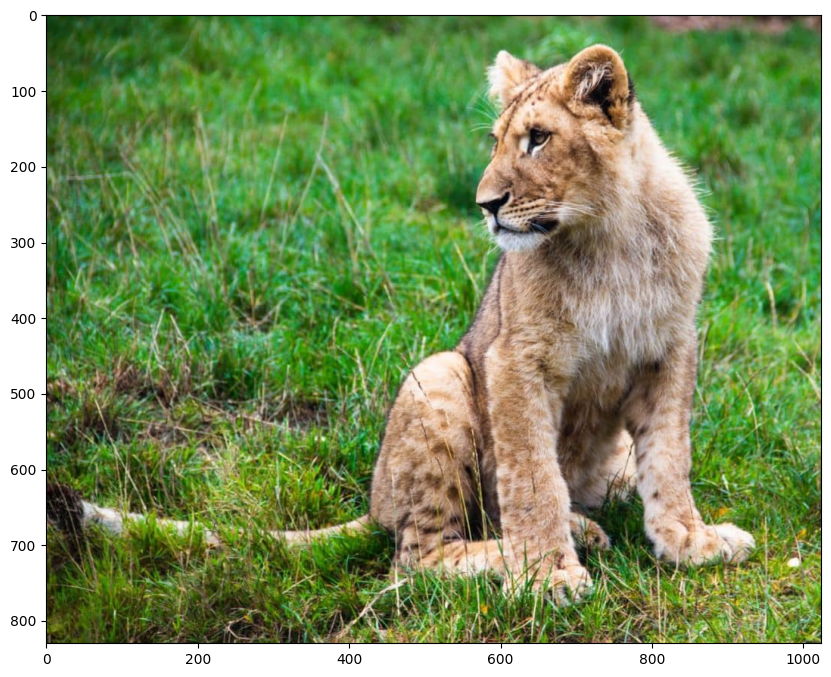

In [49]:
#work with different color channel
tiger_array = np.array(tiger)
plt.figure(figsize=(10,10))
plt.imshow(tiger_array)
plt.show()

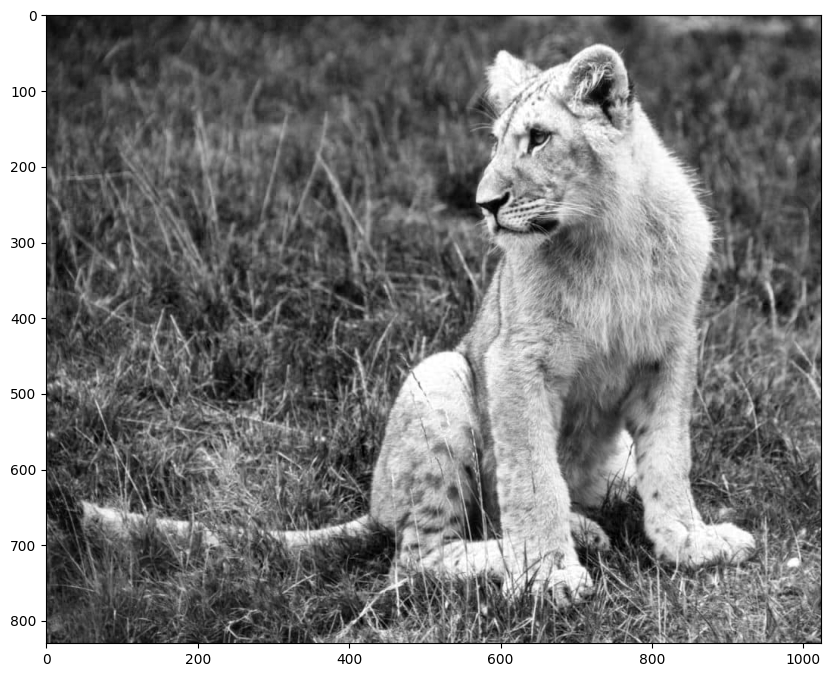

In [50]:
#plot the grayscale color map
tiger_array = np.array(tiger)
plt.figure(figsize=(10,10))
plt.imshow(tiger_array[:,:,0], cmap='gray')
plt.show()

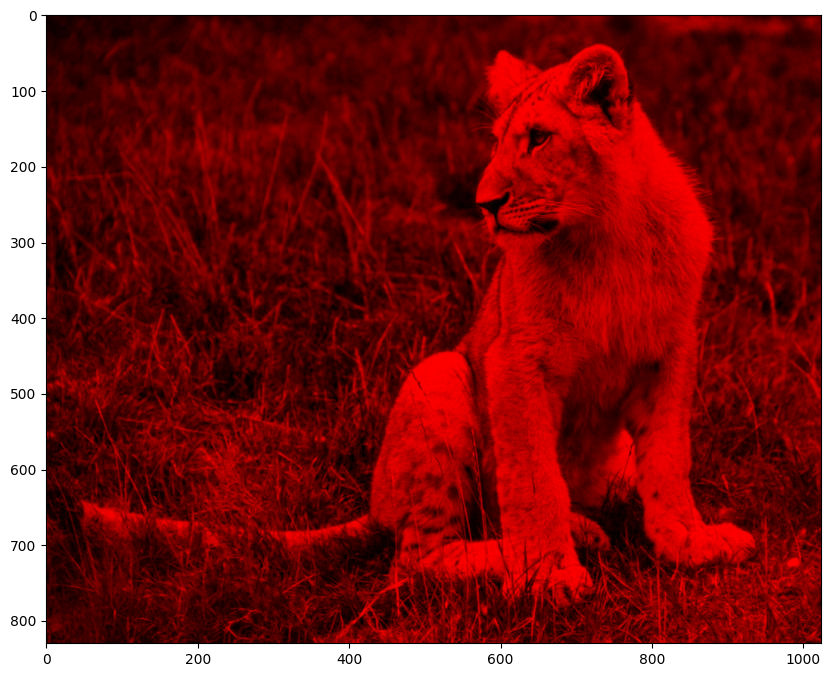

In [51]:
#plot the red channel map
tiger_red= tiger_array.copy()
tiger_red[:,:,1] = 0
tiger_red[:,:,2] = 0
plt.figure(figsize=(10,10))
plt.imshow(tiger_red)
plt.show()

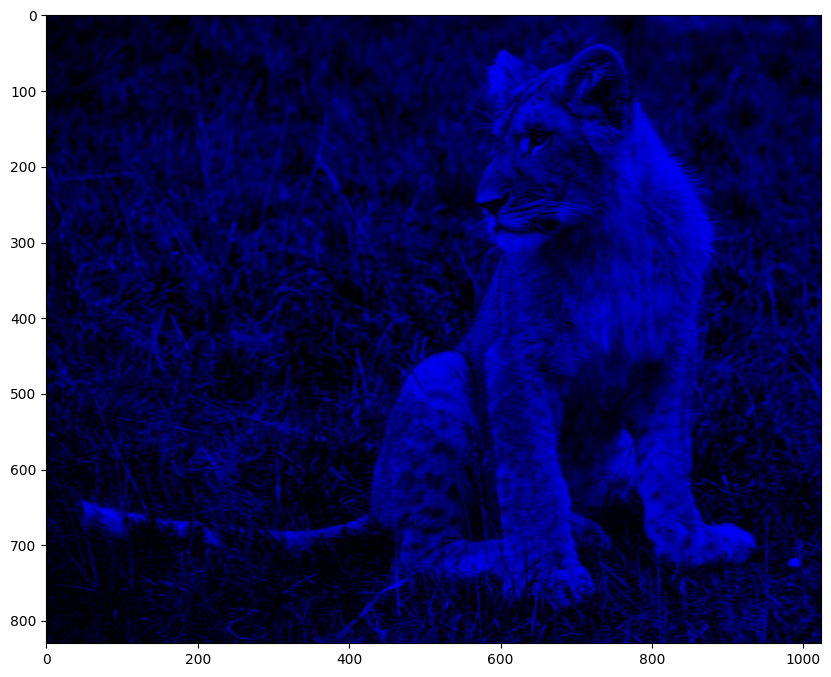

In [53]:
#plot the blue color channel map
tiger_blue= tiger_array.copy()
tiger_blue[:,:,0] = 0
tiger_blue[:,:,1] = 0
plt.figure(figsize=(10,10))
plt.imshow(tiger_blue)
plt.show()

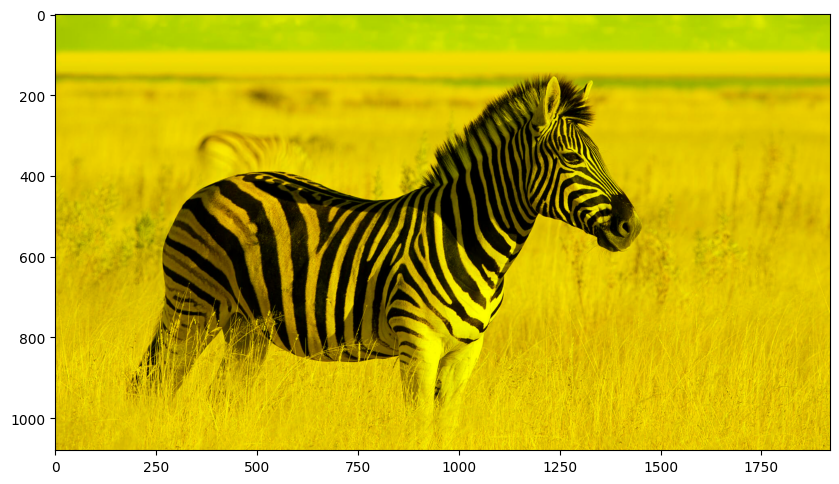

In [57]:
#Exercise: use zebra image, convert it into blue image

blue_zebra = Image.open('zebra.jpg')
blue_array = np.array(blue_zebra)
blue_array[:,:,2] = 0
plt.figure(figsize=(10,10))
plt.imshow(blue_array)
plt.show()

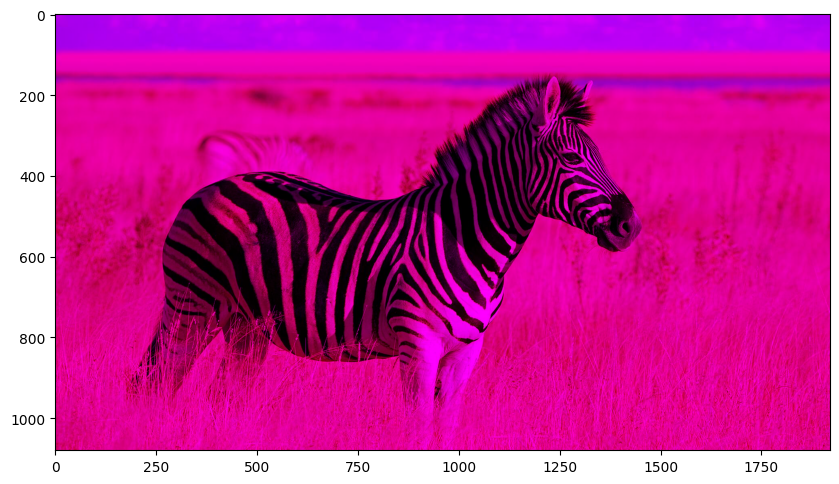

In [58]:
blue_zebra = Image.open('zebra.jpg')
blue_array = np.array(blue_zebra)
blue_array[:,:,1] = 0
plt.figure(figsize=(10,10))
plt.imshow(blue_array)
plt.show()

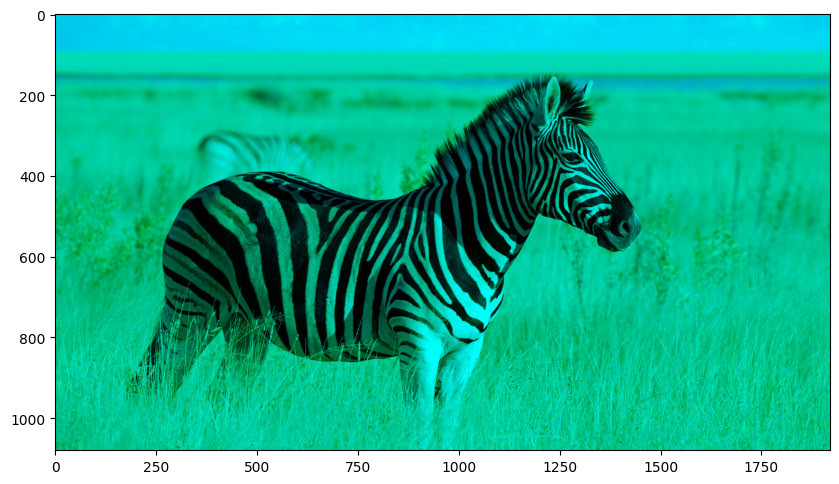

In [60]:
blue_zebra = Image.open('zebra.jpg')
blue_array = np.array(blue_zebra)
blue_array[:,:,0] = 0
plt.figure(figsize=(10,10))
plt.imshow(blue_array)
plt.show()